# <center> Base de Dados Pessoa Física <center>
# 1. Clusterização utilizando K-Means, Hierarchical e DBSCAN <center>


## 1.1 Pré-processamento

In [1]:
#importando biblotecas
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import (
    KMeans, DBSCAN
)
from sklearn.mixture import GaussianMixture
from sklearn.decomposition import PCA
from sklearn.metrics import silhouette_score
from yellowbrick.cluster import KElbowVisualizer

In [2]:
# df_pf = pd.read_csv('../dados/PF_tratados.csv')
df_pf = pd.read_csv('/home/hub/Área de Trabalho/dados/PF_tratados.csv')
df_pf.head()

,ID Cliente,Linha de Ação,Produto GPOM,Data de Venda,Classe de Serviço,Data de Nascimento,Gênero,Cidade,Microrregião,Estado,Fim de Vigência,Tipo Pessoa,Área de Atuação,Área de Atuação e Produto GPOM,Idade,Tempo de Contrato,Longitude,Latitude
0,56943,EDUCACAO,COLEGIO SESI NOVO ENSINO MEDIO,2022-10-28,ENSINO MEDIO – ITINERARIOS,2008-05-16,MASCULINO,CURITIBA,CURITIBA,PR,2023-12-15,FÍSICA,NÃO INFORMADO,COLEGIO SESI NOVO ENSINO MEDIO / NÃO INFORMADO,14,413,-49.264622,-25.419547
1,19906,EDUCACAO,EDUCACAO INFANTIL,2023-01-13,EDUCACAO INFANTIL - PRE-ESCOLA,1981-08-13,FEMININO,CURITIBA,CURITIBA,PR,2023-12-25,FÍSICA,NÃO INFORMADO,EDUCACAO INFANTIL / NÃO INFORMADO,41,346,-49.264622,-25.419547
2,19906,EDUCACAO,ENSINO FUNDAMENTAL INTERNACIONAL,2021-10-07,ENSINO FUNDAMENTAL - 1º AO 5º ANO,1981-08-13,FEMININO,CURITIBA,CURITIBA,PR,2022-12-14,FÍSICA,NÃO INFORMADO,ENSINO FUNDAMENTAL INTERNACIONAL / NÃO INFORMADO,40,433,-49.264622,-25.419547
3,19906,EDUCACAO,ENSINO FUNDAMENTAL INTERNACIONAL,2023-01-13,ENSINO FUNDAMENTAL - 1º AO 5º ANO,1981-08-13,FEMININO,CURITIBA,CURITIBA,PR,2023-12-25,FÍSICA,NÃO INFORMADO,ENSINO FUNDAMENTAL INTERNACIONAL / NÃO INFORMADO,41,346,-49.264622,-25.419547
4,6940,EDUCACAO,COLEGIO SESI INTERNACIONAL,2021-10-14,ENSINO MEDIO,2006-11-01,FEMININO,CURITIBA,CURITIBA,PR,2022-12-14,FÍSICA,NÃO INFORMADO,COLEGIO SESI INTERNACIONAL / NÃO INFORMADO,14,426,-49.264622,-25.419547


In [3]:
# Encontre o índice da linha com o valor máximo de 'Tempo de Contrato'
indice_max_tempo_contrato = df_pf['Tempo de Contrato'].idxmax()
# Use o índice para excluir a linha do DataFrame
df_pf = df_pf.drop(indice_max_tempo_contrato)

In [4]:
df_pf.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 83871 entries, 0 to 83871
Data columns (total 18 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   ID Cliente                      83871 non-null  int64  
 1   Linha de Ação                   83871 non-null  object 
 2   Produto GPOM                    83871 non-null  object 
 3   Data de Venda                   83871 non-null  object 
 4   Classe de Serviço               83871 non-null  object 
 5   Data de Nascimento              83871 non-null  object 
 6   Gênero                          83871 non-null  object 
 7   Cidade                          83871 non-null  object 
 8   Microrregião                    83871 non-null  object 
 9   Estado                          83871 non-null  object 
 10  Fim de Vigência                 83871 non-null  object 
 11  Tipo Pessoa                     83871 non-null  object 
 12  Área de Atuação                 

In [5]:
df_pf.describe()

,ID Cliente,Idade,Tempo de Contrato,Longitude,Latitude
count,83871.00000,83871.000000,83871.000000,83871.000000,83871.000000
mean,50537.25141,24.114140,198.977740,-50.423973,-24.960611
std,28783.46465,10.221791,123.216886,1.634777,1.042044
min,4.00000,0.000000,-666.000000,-70.772154,-31.764898
25%,25930.00000,16.000000,139.000000,-51.462317,-25.442949
50%,50902.00000,21.000000,166.000000,-49.307310,-25.419547
75%,74989.00000,30.000000,221.000000,-49.264622,-24.557891
max,99999.00000,78.000000,2356.000000,-34.864121,2.823842


In [6]:
# viewing descriptive df_pf
desc = pd.DataFrame(index=list(df_pf))
desc['count'] = df_pf.count()
desc['nunique'] = df_pf.nunique()
desc['%unique'] = df_pf.nunique() / len(df_pf) * 100
desc['null'] = df_pf.isnull().sum()
desc['type'] = df_pf.dtypes
desc = pd.concat([desc, df_pf.describe().T.drop('count', axis=1)], axis=1)
desc

,count,nunique,%unique,null,type,mean,std,min,25%,50%,75%,max
ID Cliente,83871,13888,16.558763,0,int64,50537.251410,28783.464650,4.000000,25930.000000,50902.000000,74989.000000,99999.000000
Linha de Ação,83871,3,0.003577,0,object,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Produto GPOM,83871,33,0.039346,0,object,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Data de Venda,83871,892,1.063538,0,object,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Classe de Serviço,83871,42,0.050077,0,object,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Data de Nascimento,83871,13919,16.595724,0,object,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Gênero,83871,2,0.002385,0,object,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Cidade,83871,574,0.684384,0,object,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Microrregião,83871,37,0.044115,0,object,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Estado,83871,25,0.029808,0,object,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [7]:
s = (df_pf.dtypes == 'object')
object_cols = list(s[s].index)

print("Variáveis categóricas na base de dados:", object_cols)

Variáveis categóricas na base de dados: ['Linha de Ação', 'Produto GPOM', 'Data de Venda', 'Classe de Serviço', 'Data de Nascimento', 'Gênero', 'Cidade', 'Microrregião', 'Estado', 'Fim de Vigência', 'Tipo Pessoa', 'Área de Atuação', 'Área de Atuação e Produto GPOM']


In [8]:
LE=LabelEncoder()
for i in object_cols:
    df_pf[i]=df_pf[[i]].apply(LE.fit_transform)

In [9]:
df_pf.head()

,ID Cliente,Linha de Ação,Produto GPOM,Data de Venda,Classe de Serviço,Data de Nascimento,Gênero,Cidade,Microrregião,Estado,Fim de Vigência,Tipo Pessoa,Área de Atuação,Área de Atuação e Produto GPOM,Idade,Tempo de Contrato,Longitude,Latitude
0,56943,0,10,562,15,12147,1,140,10,16,972,0,17,40,14,413,-49.264622,-25.419547
1,19906,0,17,626,9,3075,0,140,10,16,982,0,17,47,41,346,-49.264622,-25.419547
2,19906,0,20,237,12,3075,0,140,10,16,634,0,17,50,40,433,-49.264622,-25.419547
3,19906,0,20,626,12,3075,0,140,10,16,982,0,17,50,41,346,-49.264622,-25.419547
4,6940,0,8,242,14,11593,0,140,10,16,634,0,17,38,14,426,-49.264622,-25.419547


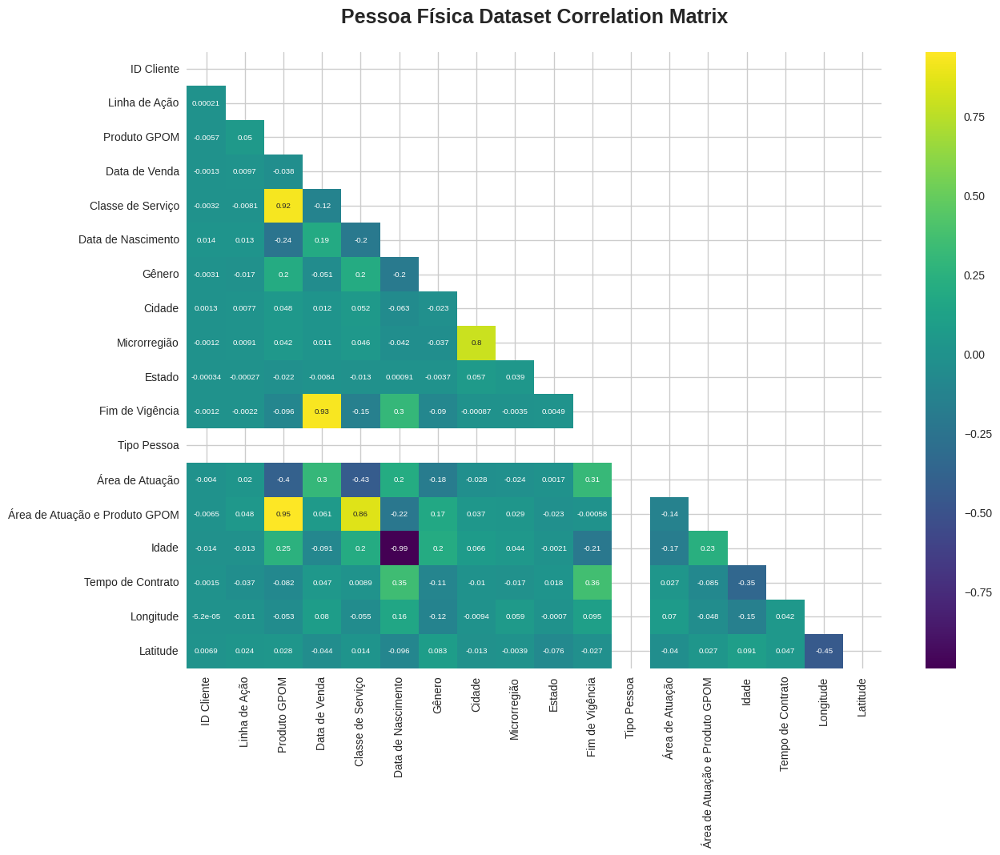

In [10]:
def heatmap(dataset, label = None):
    corr = dataset.corr(method = 'spearman')
    plt.figure(figsize = (14, 10), dpi = 100)
    mask = np.zeros_like(corr)
    mask[np.triu_indices_from(mask)] = True
    sns.heatmap(corr, mask = mask, cmap = 'viridis', annot = True, annot_kws = {'size' : 7})
    plt.title(f'{label} Dataset Correlation Matrix\n', fontsize = 18, weight = 'bold')
    plt.show()
heatmap(df_pf, 'Pessoa Física')

In [11]:
df_pf.columns

Index(['ID Cliente', 'Linha de Ação', 'Produto GPOM', 'Data de Venda',
       'Classe de Serviço', 'Data de Nascimento', 'Gênero', 'Cidade',
       'Microrregião', 'Estado', 'Fim de Vigência', 'Tipo Pessoa',
       'Área de Atuação', 'Área de Atuação e Produto GPOM', 'Idade',
       'Tempo de Contrato', 'Longitude', 'Latitude'],
      dtype='object')

In [12]:
# Calcule a frequência de compras para cada cliente
frequencia_compras = df_pf.groupby(['ID Cliente', 'Data de Nascimento'])['Data de Venda'].count().reset_index()
frequencia_compras.columns = ['ID Cliente', 'Data de Nascimento', 'Frequencia Compras']
df_pf = pd.merge(df_pf, frequencia_compras, on=['ID Cliente', 'Data de Nascimento'], how='left')

In [13]:
cols_del = ['Data de Venda', 'Data de Nascimento', 'Fim de Vigência', 'Tipo Pessoa','Longitude', 'Latitude']
df_pf = df_pf.drop(cols_del, axis=1)

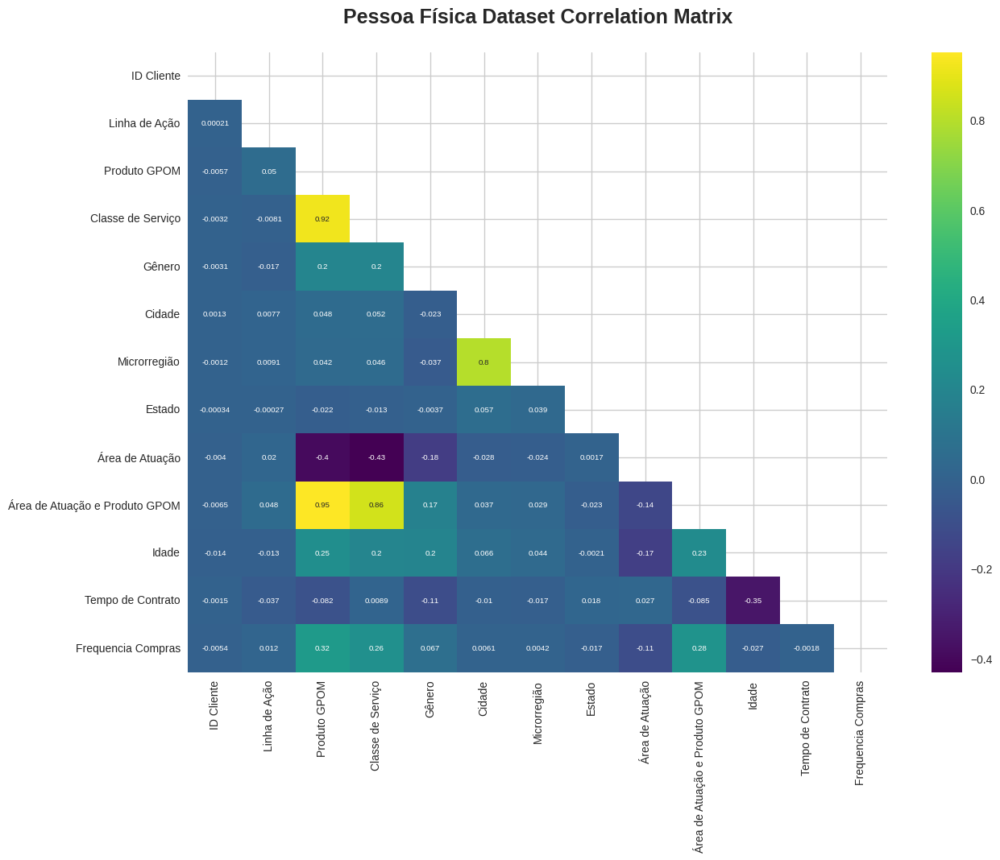

In [14]:
heatmap(df_pf, 'Pessoa Física')

In [15]:
df_pf

,ID Cliente,Linha de Ação,Produto GPOM,Classe de Serviço,Gênero,Cidade,Microrregião,Estado,Área de Atuação,Área de Atuação e Produto GPOM,Idade,Tempo de Contrato,Frequencia Compras
0,56943,0,10,15,1,140,10,16,17,40,14,413,1
1,19906,0,17,9,0,140,10,16,17,47,41,346,3
2,19906,0,20,12,0,140,10,16,17,50,40,433,3
3,19906,0,20,12,0,140,10,16,17,50,41,346,3
4,6940,0,8,14,0,140,10,16,17,38,14,426,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...
83866,13908,0,30,39,1,44,30,16,14,86,41,176,1
83867,60900,0,1,1,1,222,6,16,7,17,29,11,1
83868,1045,0,1,1,1,135,20,21,2,13,19,85,1
83869,69940,0,1,1,1,306,24,16,20,30,30,4,1


In [16]:
scaler = StandardScaler()
scaler.fit(df_pf)
scaled_df_pf = pd.DataFrame(scaler.transform(df_pf),columns= df_pf.columns )
print("Todos os atributos estão normalizados")

Todos os atributos estão normalizados


In [17]:
scaled_df_pf

,ID Cliente,Linha de Ação,Produto GPOM,Classe de Serviço,Gênero,Cidade,Microrregião,Estado,Área de Atuação,Área de Atuação e Produto GPOM,Idade,Tempo de Contrato,Frequencia Compras
0,0.222551,-0.042048,-1.093599,-0.826452,0.564908,-0.744418,-0.689030,-0.052528,0.481198,-1.018850,-0.989474,1.736966,-1.095264
1,-1.064202,-0.042048,-0.423165,-1.272559,-1.770201,-0.744418,-0.689030,-0.052528,0.481198,-0.713979,1.651957,1.193206,0.187118
2,-1.064202,-0.042048,-0.135837,-1.049506,-1.770201,-0.744418,-0.689030,-0.052528,0.481198,-0.583320,1.554126,1.899282,0.187118
3,-1.064202,-0.042048,-0.135837,-1.049506,-1.770201,-0.744418,-0.689030,-0.052528,0.481198,-0.583320,1.651957,1.193206,0.187118
4,-1.514672,-0.042048,-1.285151,-0.900803,-1.770201,-0.744418,-0.689030,-0.052528,0.481198,-1.105956,-0.989474,1.842472,0.828309
...,...,...,...,...,...,...,...,...,...,...,...,...,...
83866,-1.272587,-0.042048,0.821925,0.957976,0.564908,-1.348104,1.366739,-0.052528,-0.057084,0.984587,1.651957,-0.186483,-1.095264
83867,0.360027,-0.042048,-1.955585,-1.867368,0.564908,-0.228770,-1.100183,-0.052528,-1.313075,-2.020568,0.477988,-1.525593,-1.095264
83868,-1.719478,-0.042048,-1.955585,-1.867368,0.564908,-0.775860,0.338855,6.443410,-2.210211,-2.194780,-0.500320,-0.925023,-1.095264
83869,0.674098,-0.042048,-1.955585,-1.867368,0.564908,0.299454,0.750008,-0.052528,1.019480,-1.454380,0.575818,-1.582404,-1.095264


In [19]:
df_pf.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 83871 entries, 0 to 83870
Data columns (total 13 columns):
 #   Column                          Non-Null Count  Dtype
---  ------                          --------------  -----
 0   ID Cliente                      83871 non-null  int64
 1   Linha de Ação                   83871 non-null  int64
 2   Produto GPOM                    83871 non-null  int64
 3   Classe de Serviço               83871 non-null  int64
 4   Gênero                          83871 non-null  int64
 5   Cidade                          83871 non-null  int64
 6   Microrregião                    83871 non-null  int64
 7   Estado                          83871 non-null  int64
 8   Área de Atuação                 83871 non-null  int64
 9   Área de Atuação e Produto GPOM  83871 non-null  int64
 10  Idade                           83871 non-null  int64
 11  Tempo de Contrato               83871 non-null  int64
 12  Frequencia Compras              83871 non-null  int64
dtypes

In [20]:
pca = PCA(n_components=4)
pca.fit(scaled_df_pf)
PCA_df_pf = pca.fit_transform(scaled_df_pf)

## 1.2 Aplicação da clusterização usando K-Means

### 1.2.1 Método do cotovelo

Elbow Method to determine the number of clusters to be formed:


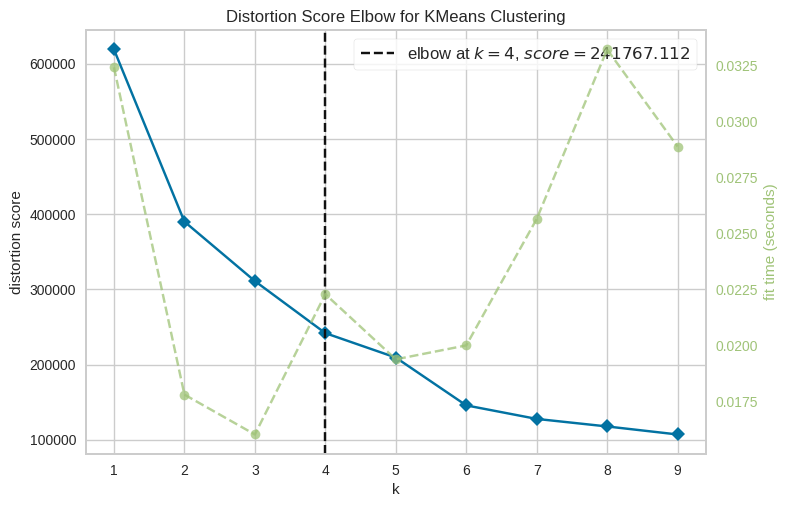

<Axes: title={'center': 'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [21]:
print('Elbow Method to determine the number of clusters to be formed:')
Elbow_M = KElbowVisualizer(KMeans(), k=(1,10))
Elbow_M.fit(PCA_df_pf)
Elbow_M.show()

In [22]:
# Note: K-Means is a popular centroid-based clustering algorithm.
kmeans = KMeans(n_clusters=4, random_state=42)
kmeans_labels = kmeans.fit_predict(PCA_df_pf)
kmeans_score = silhouette_score(PCA_df_pf, kmeans_labels)

In [23]:
df_pf['Clusters_KMeans']= kmeans_labels
PCA_df_pf = pd.DataFrame(pca.transform(scaled_df_pf))
PCA_df_pf['Clusters_KMeans']=kmeans_labels

In [24]:
import plotly.graph_objects as go

x = PCA_df_pf[0]
y = PCA_df_pf[1]
z = PCA_df_pf[2]
c = df_pf['Clusters_KMeans']
fig = go.Figure()
scatter = go.Scatter3d(
    x=x,
    y=y,
    z=z,
    mode='markers',
    marker=dict(
        size=6,
        color=c,
        colorscale='viridis',
        opacity=0.8
    ),
    name='Data Points'
)
fig.add_trace(scatter)
fig.update_layout(
    scene=dict(
        xaxis_title='Principal Component 1',
        yaxis_title='Principal Component 2',
        zaxis_title='Principal Component 3',
        camera=dict(
            eye=dict(x=1.5, y=1.5, z=1.5)
        )
    ),
    title='3D Scatter Plot of PCA-transformed Data'
)
fig.show()

In [25]:
def plot_clusters(x, y, clusters, df=df_pf, cmap='viridis', title='Clusters Identificados pelo K-Means'):
    """
    Função para plotar um gráfico de dispersão dos clusters identificados pelo K-Means.

    Parâmetros:
    - x: Nome da coluna para o eixo x.
    - y: Nome da coluna para o eixo y.
    - clusters: Nome da coluna que contém os rótulos dos clusters.
    - df: DataFrame pandas contendo os dados (padrão: df_pf).
    - cmap: Esquema de cores a ser usado para os clusters (padrão: 'viridis').
    - title: Título do gráfico (padrão: 'Clusters Identificados pelo K-Means').
    """
    plt.scatter(df[x], df[y], c=df[clusters], cmap=cmap, s=60)
    plt.title(f'{title} - {x} vs {y}')
    plt.xlabel(x)
    plt.ylabel(y)
    plt.colorbar(label='Clusters')
    plt.show()

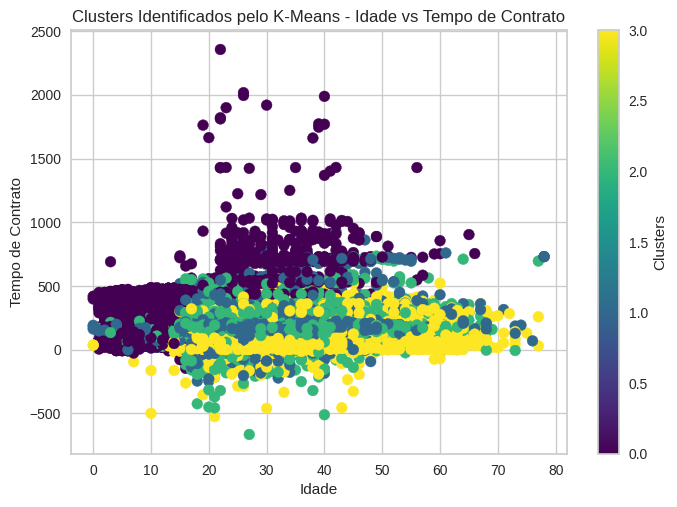

In [26]:
plot_clusters('Idade', 'Tempo de Contrato', 'Clusters_KMeans')

In [27]:
df_pf.columns

Index(['ID Cliente', 'Linha de Ação', 'Produto GPOM', 'Classe de Serviço',
       'Gênero', 'Cidade', 'Microrregião', 'Estado', 'Área de Atuação',
       'Área de Atuação e Produto GPOM', 'Idade', 'Tempo de Contrato',
       'Frequencia Compras', 'Clusters_KMeans'],
      dtype='object')

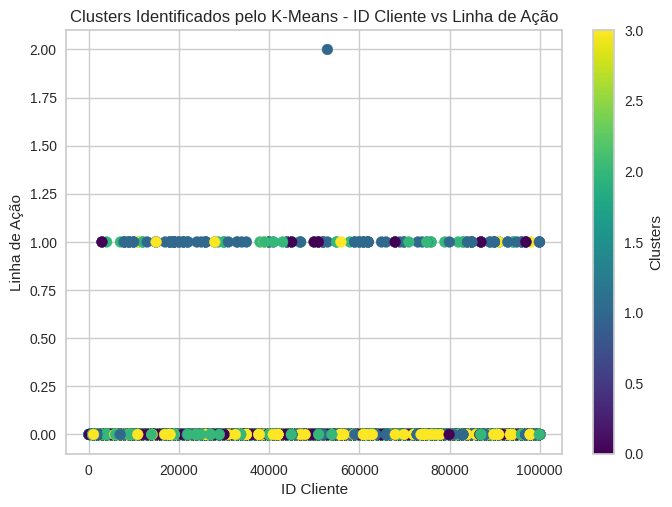

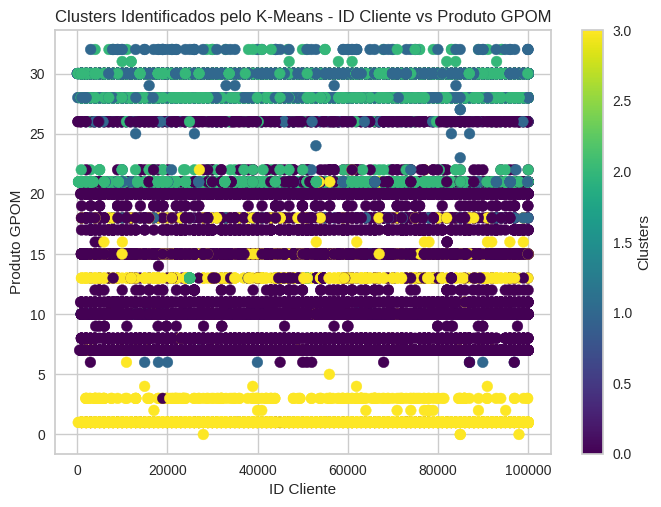

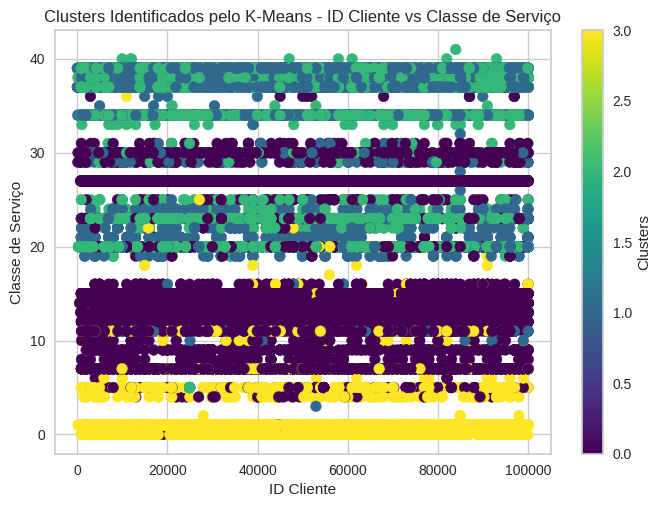

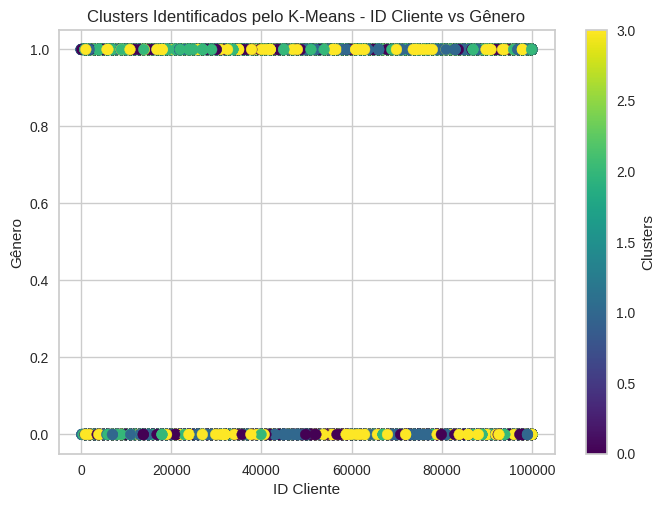

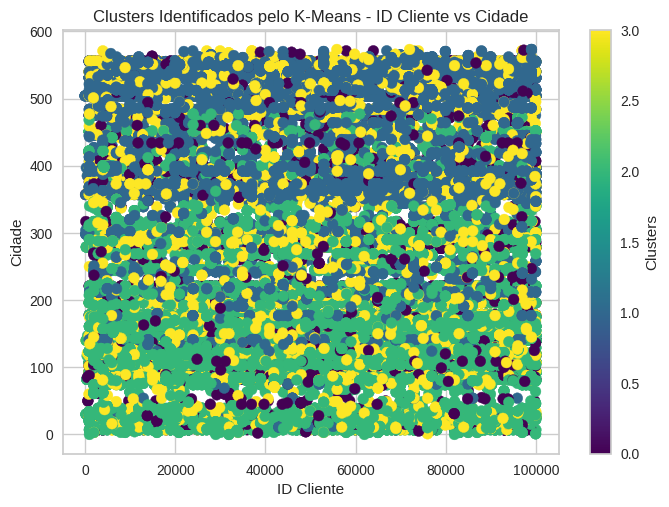

...

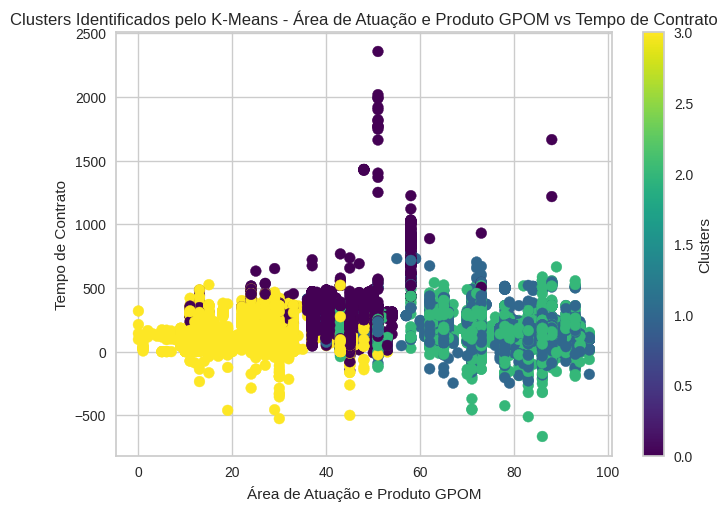

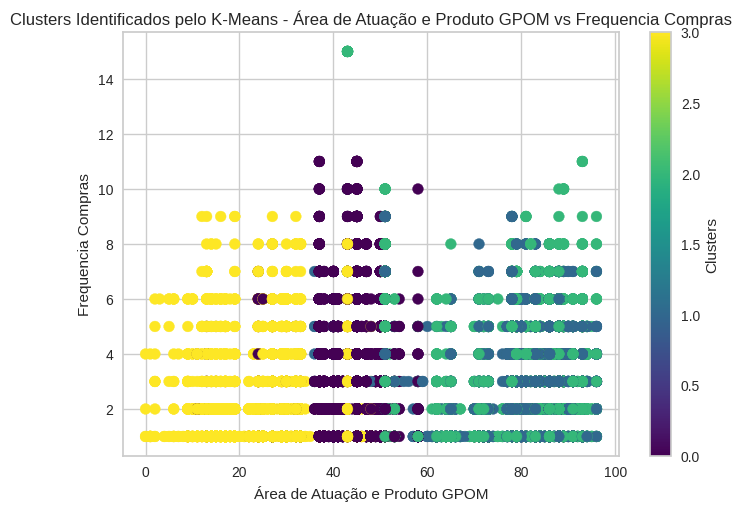

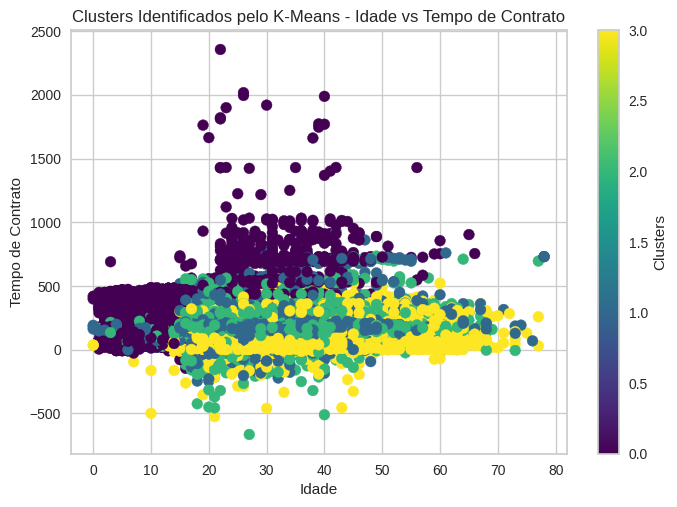

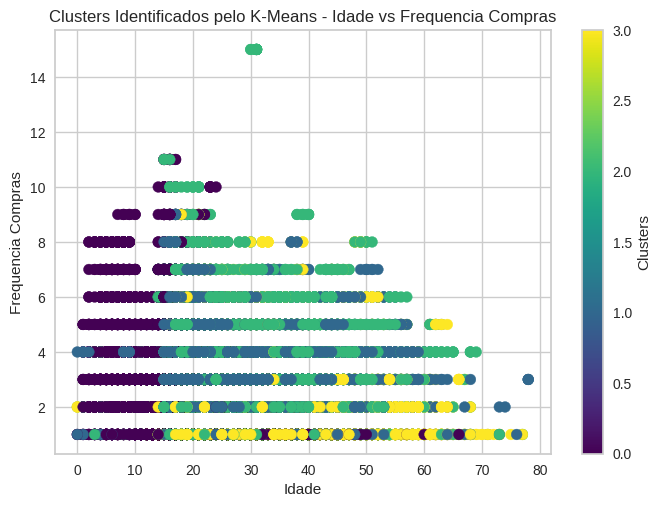

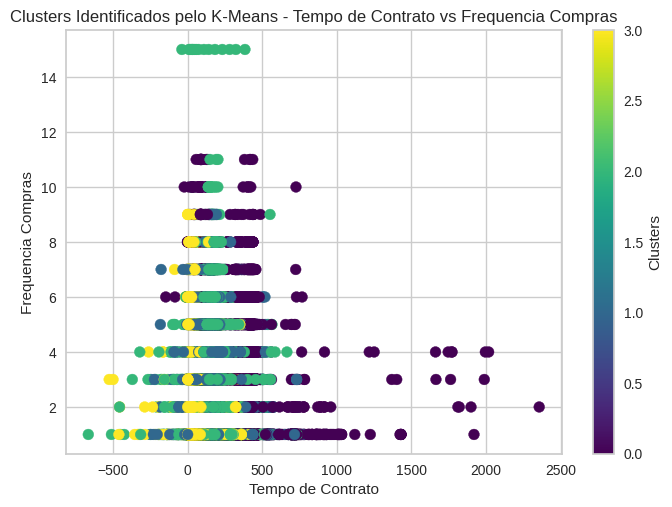

In [28]:
# Exemplo de uso com todas as variáveis possíveis:
colunas = ['ID Cliente', 'Linha de Ação', 'Produto GPOM', 'Classe de Serviço',
           'Gênero', 'Cidade', 'Microrregião', 'Estado', 'Área de Atuação',
           'Área de Atuação e Produto GPOM', 'Idade', 'Tempo de Contrato',
           'Frequencia Compras']

# Vamos visualizar os clusters para todas as combinações possíveis de variáveis:
for i in range(len(colunas)):
    for j in range(i+1, len(colunas)):
        plot_clusters(colunas[i], colunas[j], 'Clusters_KMeans')

In [29]:
PCA_df_pf.head()

,0,1,2,3,Clusters_KMeans
0,2.238768,-0.944367,0.847483,-0.673252,0
1,1.720860,-0.700342,-0.078374,0.232806,0
2,1.504302,-0.767325,0.499942,0.076555,0
3,1.381950,-0.733812,0.023239,0.225151,0
4,2.521705,-0.912701,1.930236,0.221659,0


Text(0.5, 1.0, 'Clusters nos Dados')

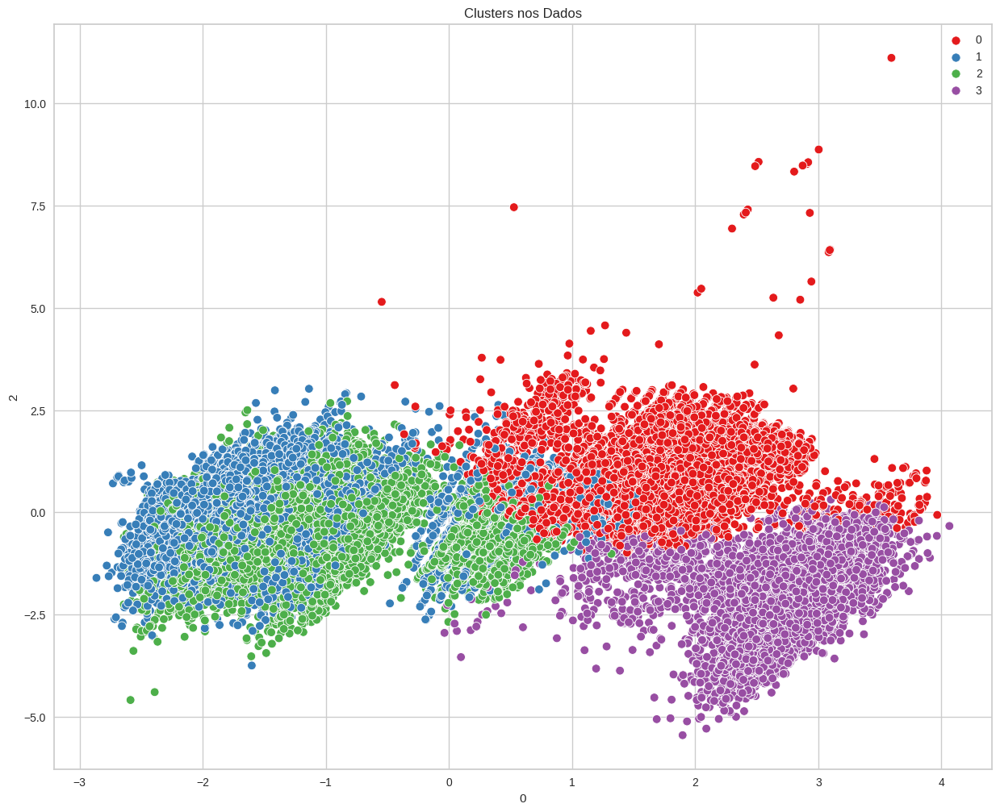

In [30]:
# plt.figure(figsize=(15,12))
# sns.scatterplot(x=PCA_df_pf[:, 0], y=PCA_df_pf[:, 2], hue=kmeans_labels,s=60, palette='Set1')
# plt.title('clusters in data')
plt.figure(figsize=(15,12))
sns.scatterplot(x=PCA_df_pf.iloc[:, 0], y=PCA_df_pf.iloc[:, 2], hue=kmeans_labels, s=60, palette='Set1')
plt.title('Clusters nos Dados')


In [31]:
print("K-Means Silhouette Score:", kmeans_score)

K-Means Silhouette Score: 0.39742761727736325


## 1.3 Aplicação da clusterização usando Hierarchical

### 1.3.1 Dendograma

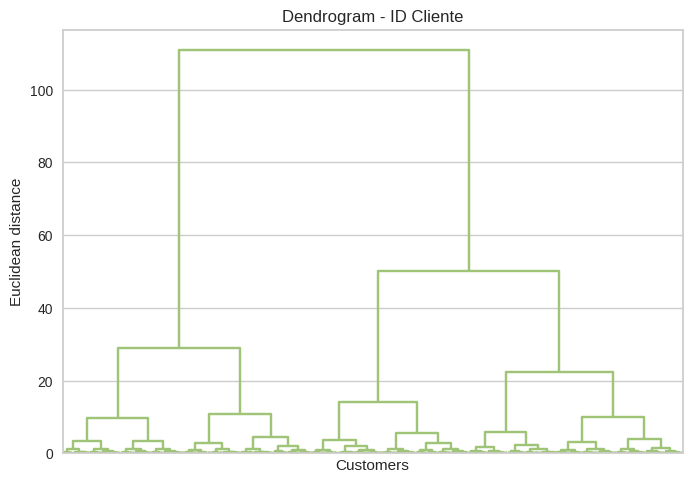

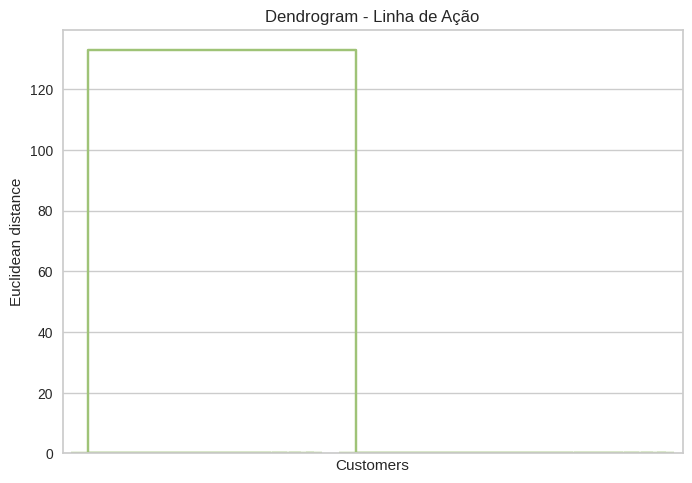

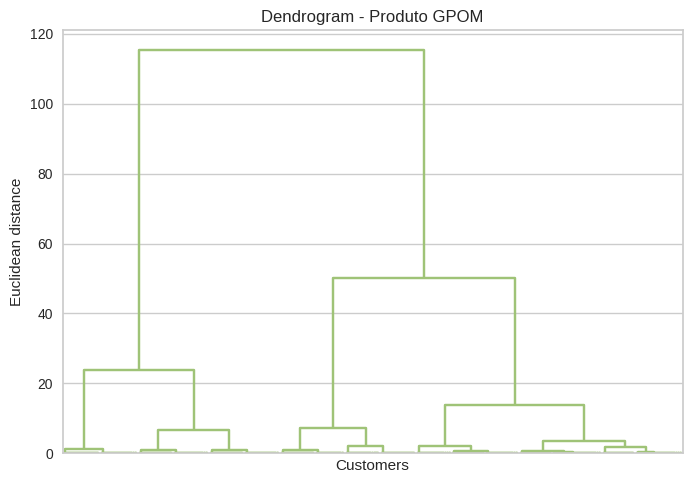

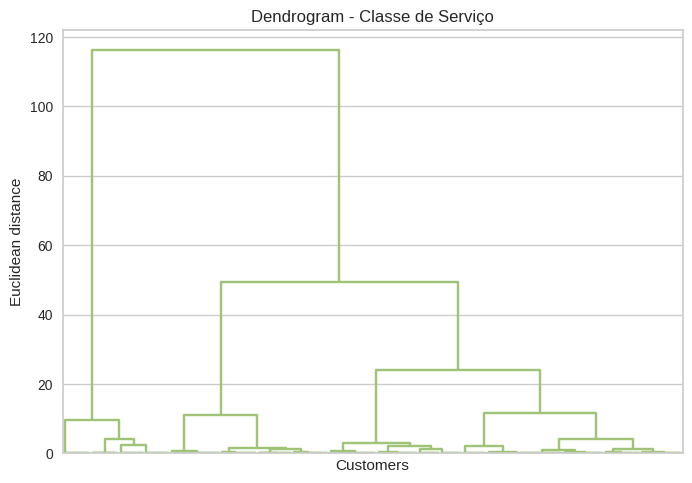

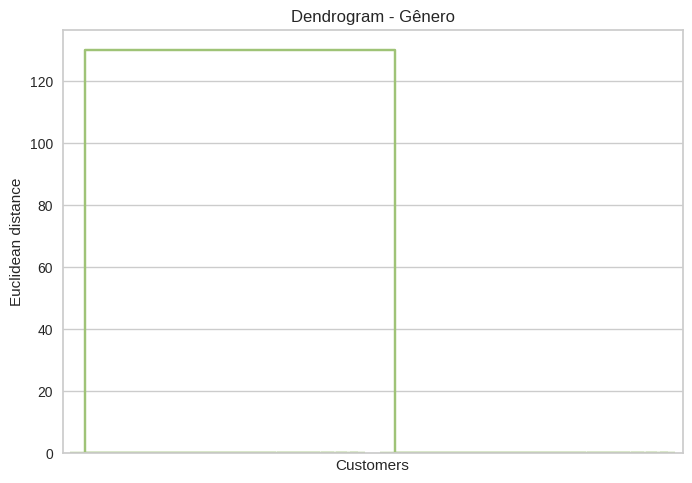

...

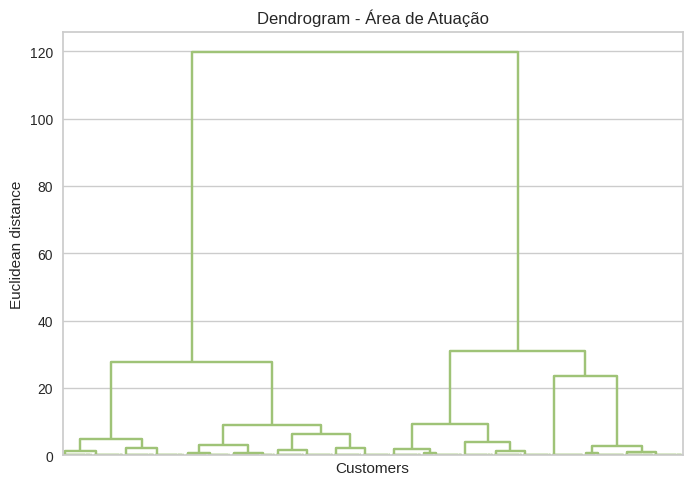

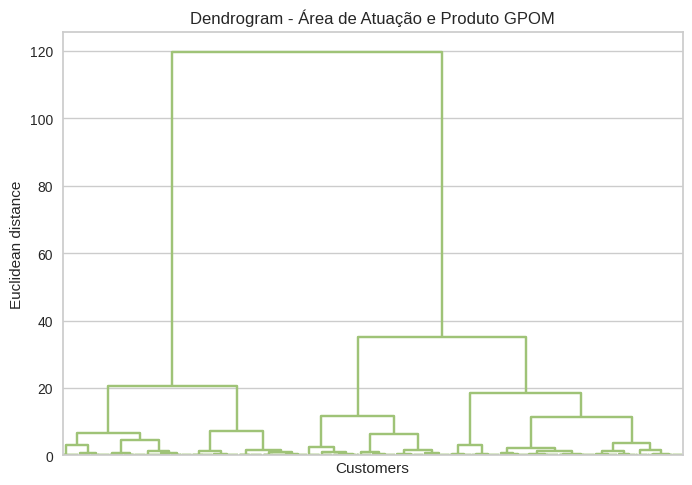

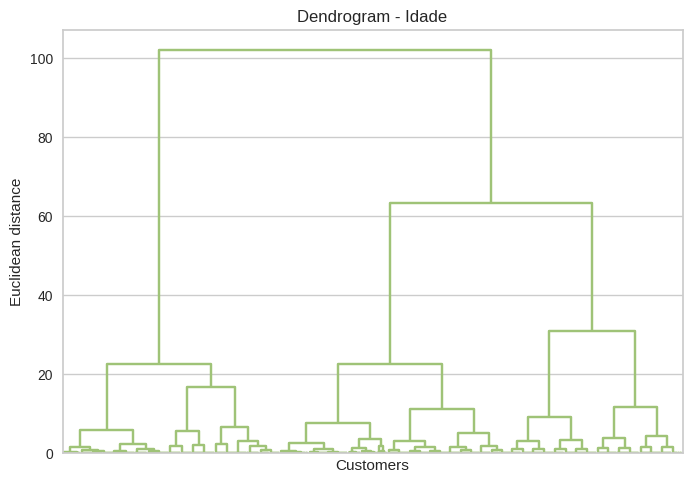

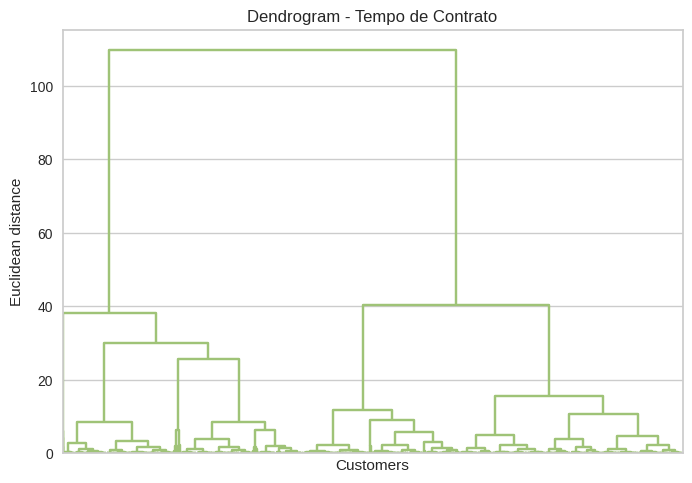

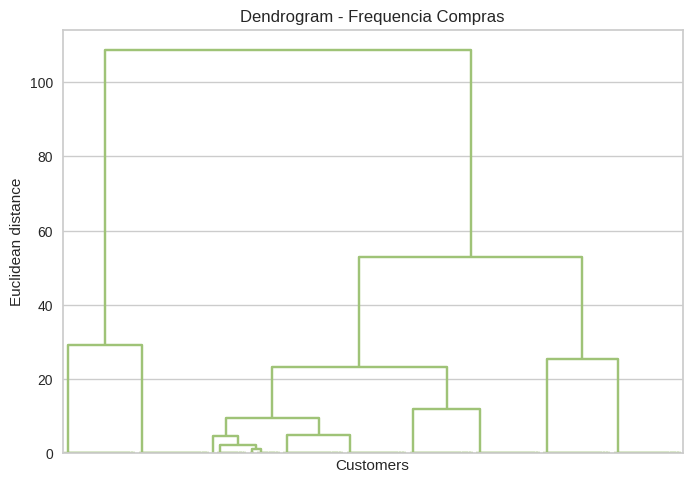

In [32]:
import scipy.cluster.hierarchy as sch
import numpy as np
import matplotlib.pyplot as plt


colunas = ['ID Cliente', 'Linha de Ação', 'Produto GPOM', 'Classe de Serviço',
           'Gênero', 'Cidade', 'Microrregião', 'Estado', 'Área de Atuação',
           'Área de Atuação e Produto GPOM', 'Idade', 'Tempo de Contrato',
           'Frequencia Compras']

# Subamostragem global
subsample_percentage = 10
num_samples = int(len(scaled_df_pf) * (subsample_percentage / 100.0))
subsample_indices = np.random.choice(len(scaled_df_pf), num_samples, replace=False)

# Iterar sobre cada coluna e gerar o dendrograma
for coluna in colunas:
    X = scaled_df_pf[coluna].values.reshape(-1, 1)  # Reshape para garantir que seja uma matriz 2D

    # Subamostragem específica para cada coluna
    X_subsampled = X[subsample_indices, :]

    # Calcular o dendrograma com alguns parâmetros ajustados
    dendrogram = sch.dendrogram(sch.linkage(X_subsampled, method='ward', metric='euclidean'),
                                color_threshold=np.inf,  # Removendo a cor automática
                                truncate_mode='level',  # Ajustando o modo de truncamento
                                p=20,  # Limitando a quantidade de folhas no último nível
                                no_labels=True)

    plt.title(f'Dendrogram - {coluna}')
    plt.xlabel('Customers')
    plt.ylabel('Euclidean distance')
    plt.show()


### 1.3.2 Agglomerative Clustering

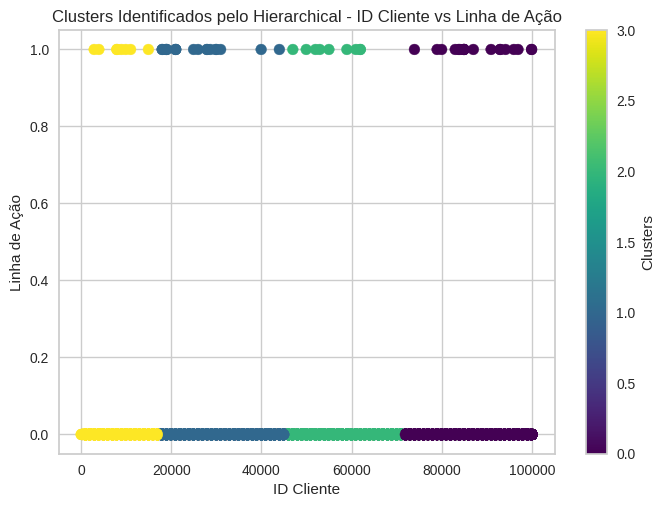

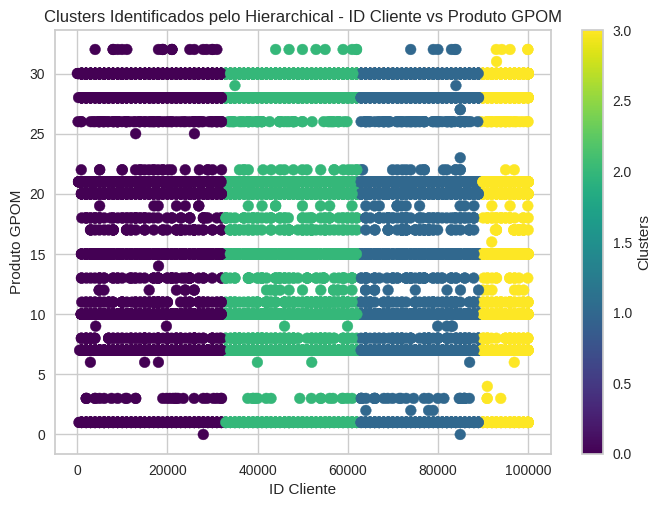

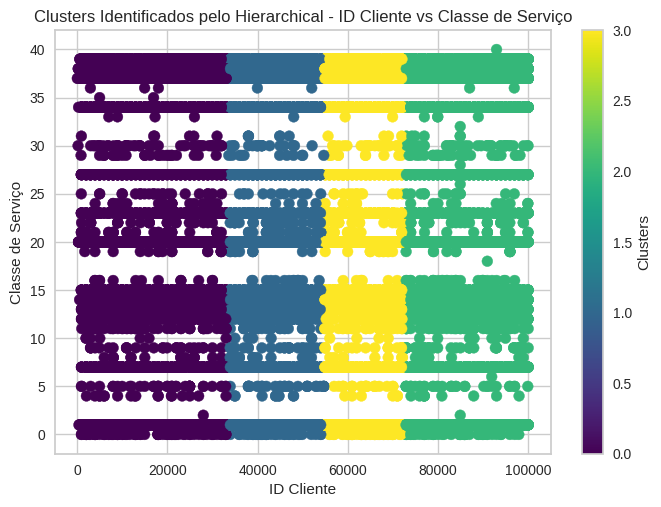

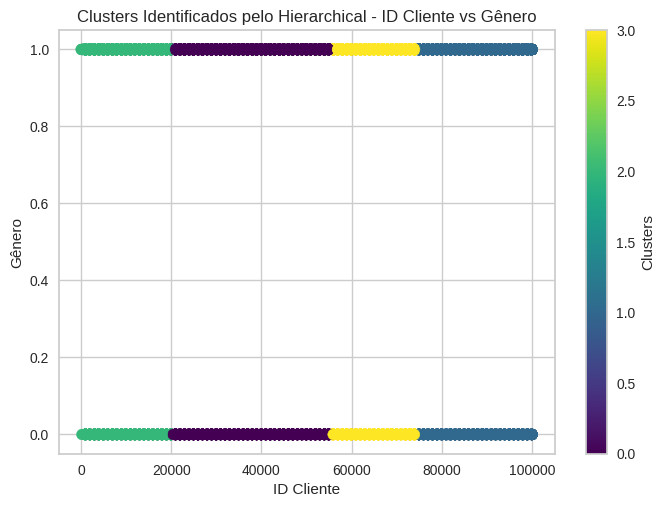

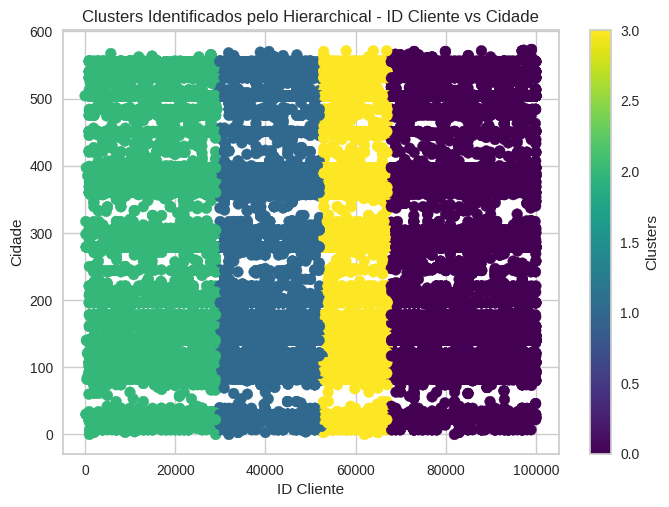

...

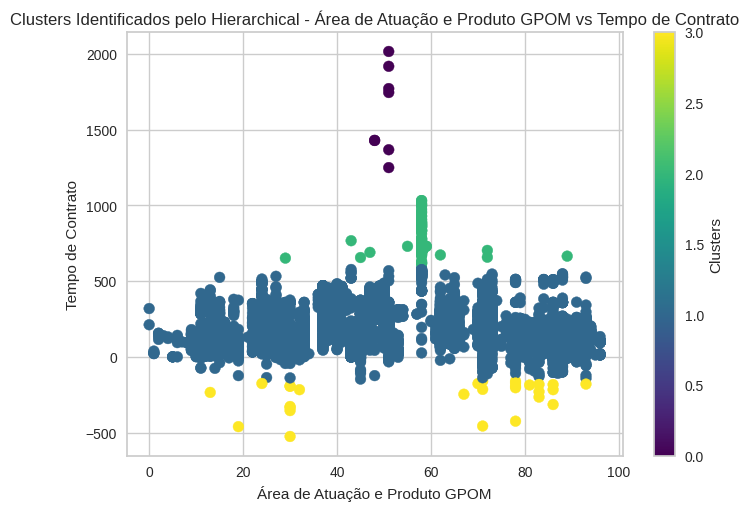

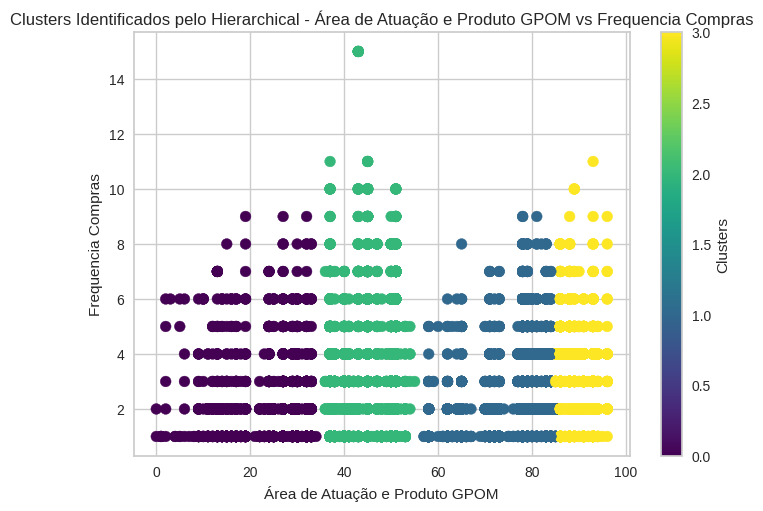

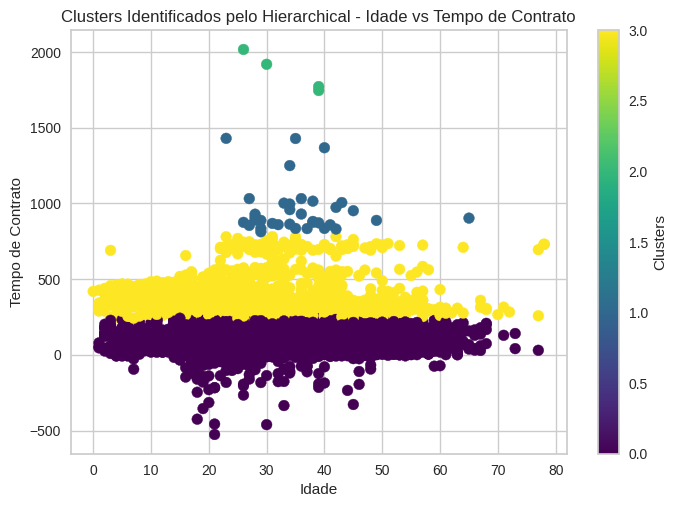

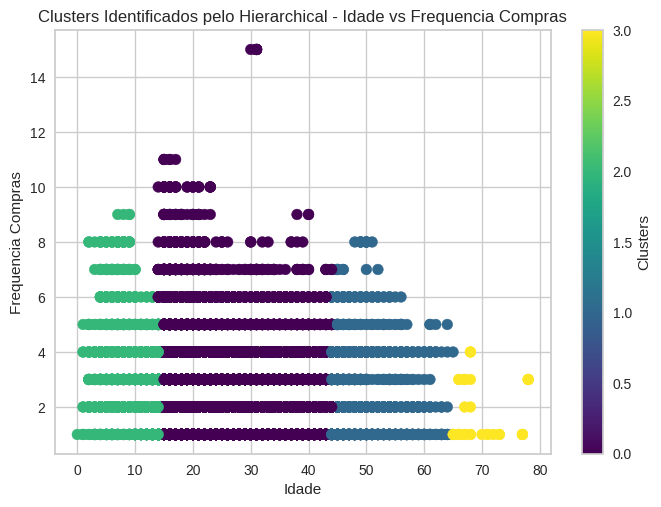

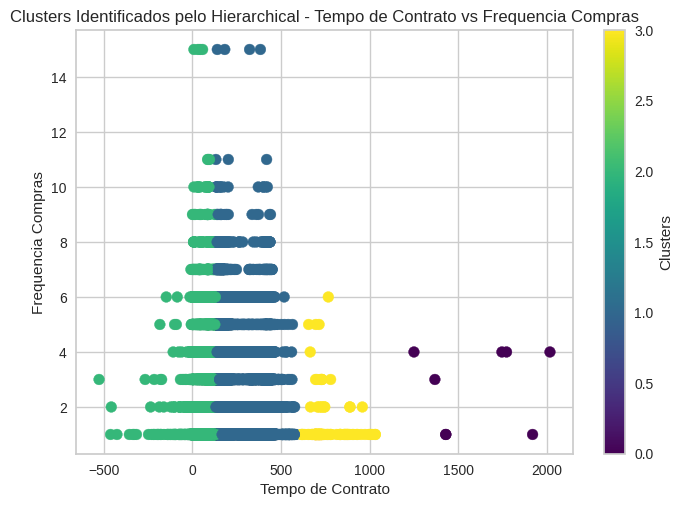

In [33]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.cluster import AgglomerativeClustering

def plot_clusters(x, y, clusters, df, cmap='viridis', title='Clusters Identificados pelo Hierarchical'):
    """
    Função para plotar um gráfico de dispersão dos clusters identificados pelo Hierarchical.

    Parâmetros:
    - x: Nome da coluna para o eixo x.
    - y: Nome da coluna para o eixo y.
    - clusters: Nome da coluna que contém os rótulos dos clusters.
    - df: DataFrame pandas contendo os dados.
    - cmap: Esquema de cores a ser usado para os clusters (padrão: 'viridis').
    - title: Título do gráfico (padrão: 'Clusters Identificados pelo Hierarchical').
    """
    plt.scatter(df[x], df[y], c=df[clusters], cmap=cmap, s=60)
    plt.title(f'{title} - {x} vs {y}')
    plt.xlabel(x)
    plt.ylabel(y)
    plt.colorbar(label='Clusters')
    plt.show()

colunas = ['ID Cliente', 'Linha de Ação', 'Produto GPOM', 'Classe de Serviço',
           'Gênero', 'Cidade', 'Microrregião', 'Estado', 'Área de Atuação',
           'Área de Atuação e Produto GPOM', 'Idade', 'Tempo de Contrato',
           'Frequencia Compras']

# Amostra de uma porção do dataframe
sampled_df = df_pf.sample(frac=0.4)  

# Iterar sobre cada par de colunas consecutivas
for i in range(len(colunas) - 1):
    for j in range(i + 1, len(colunas)):
        coluna1 = colunas[i]
        coluna2 = colunas[j]

        # Perform clustering on the sampled data for the pair of columns
        X_pair = sampled_df[[coluna1, coluna2]].values
        agg_clustering = AgglomerativeClustering(n_clusters=4, linkage='complete')
        sampled_df[f'Cluster_{coluna1}_{coluna2}'] = agg_clustering.fit_predict(X_pair)

        # Visualize the clusters for the current pair of columns
        plot_clusters(coluna1, coluna2, f'Cluster_{coluna1}_{coluna2}', df=sampled_df)


In [34]:
from sklearn.metrics import silhouette_score

# Calcular o coeficiente de silhueta para os clusters produzidos pelo Hierarchical Clustering
silhouette_avg = silhouette_score(X_pair, agg_clustering.labels_)

print("Hierarchical Clustering Silhouette Score:", silhouette_avg)


Hierarchical Clustering Silhouette Score: 0.33704007560941274


## 1.4 Aplicação da clusterização usando DBSCAN

In [35]:
pca = PCA(n_components=3)
pca.fit(scaled_df_pf)
PCA_df_pf = pd.DataFrame(pca.transform(scaled_df_pf))
PCA_df_pf.describe().T

,count,mean,std,min,25%,50%,75%,max
0,83871.0,-1.355496e-17,1.789159,-2.862766,-1.610240,-0.780925,1.824028,4.065029
1,83871.0,-7.590780e-17,1.350873,-2.602840,-1.077529,-0.470183,1.077800,3.413371
2,83871.0,2.033245e-17,1.155237,-5.447750,-0.597076,0.084912,0.718190,11.109559


In [36]:
# Aplicação do DBSCAN
eps = 0.4
min_samples = 10 
db = DBSCAN(eps=eps, min_samples=min_samples)
db.fit(PCA_df_pf)
clusters = db.labels_

dbscan_labels = db.fit_predict(PCA_df_pf)

n_clusters_ = len(set(clusters)) - (1 if -1 in clusters else 0)
n_noise_ = list(clusters).count(-1)

print("Number of clusters: %d" % n_clusters_)
print("Number of noise points: %d" % n_noise_)

dbscan_score = silhouette_score(PCA_df_pf, dbscan_labels)

Number of clusters: 2
Number of noise points: 242


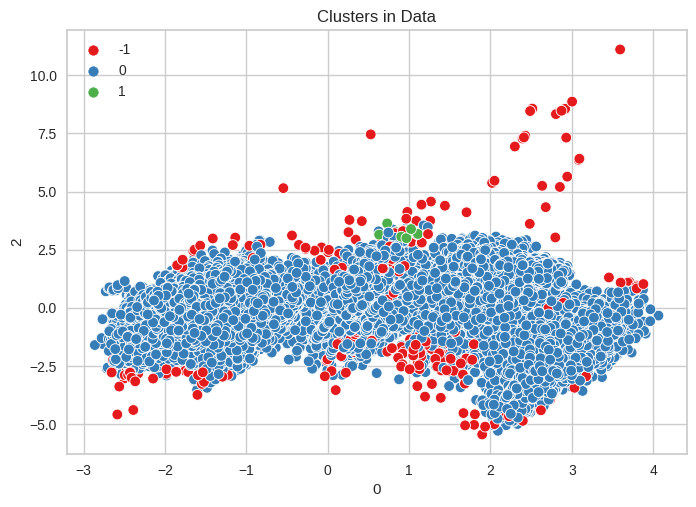

In [37]:
sns.scatterplot(x=PCA_df_pf.iloc[:, 0], y=PCA_df_pf.iloc[:, 2], hue=dbscan_labels, s=60, palette='Set1')
plt.title('Clusters in Data')
plt.show()

In [38]:
df_pf['Clusters_DBSCAN']= dbscan_labels

In [39]:
def plot_clusters(x, y, clusters, df=df_pf, cmap='viridis', title=f'Clusters Identificados pelo DBSCAN'):
    """
    Função para plotar um gráfico de dispersão dos clusters identificados pelo K-Means.

    Parâmetros:
    - x: Nome da coluna para o eixo x.
    - y: Nome da coluna para o eixo y.
    - clusters: Nome da coluna que contém os rótulos dos clusters.
    - df: DataFrame pandas contendo os dados (padrão: df_pf).
    - cmap: Esquema de cores a ser usado para os clusters (padrão: 'viridis').
    - title: Título do gráfico (padrão: 'Clusters Identificados pelo K-Means').
    """
    plt.scatter(df[x], df[y], c=df[clusters], cmap=cmap, s=60)
    plt.title(f'{title} - {x} vs {y}')
    plt.xlabel(x)
    plt.ylabel(y)
    plt.colorbar(label='Clusters')
    plt.show()


In [40]:
df_pf.columns

Index(['ID Cliente', 'Linha de Ação', 'Produto GPOM', 'Classe de Serviço',
       'Gênero', 'Cidade', 'Microrregião', 'Estado', 'Área de Atuação',
       'Área de Atuação e Produto GPOM', 'Idade', 'Tempo de Contrato',
       'Frequencia Compras', 'Clusters_KMeans', 'Clusters_DBSCAN'],
      dtype='object')

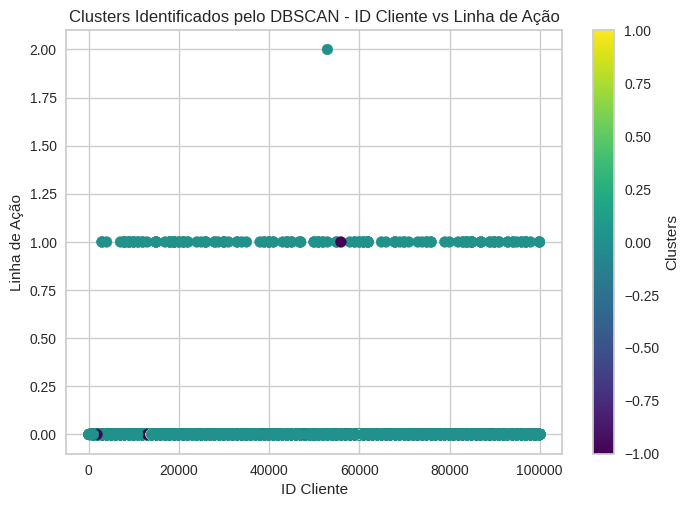

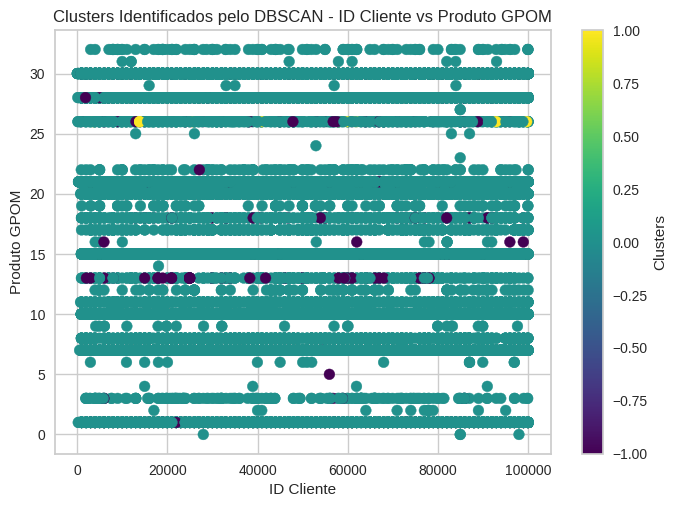

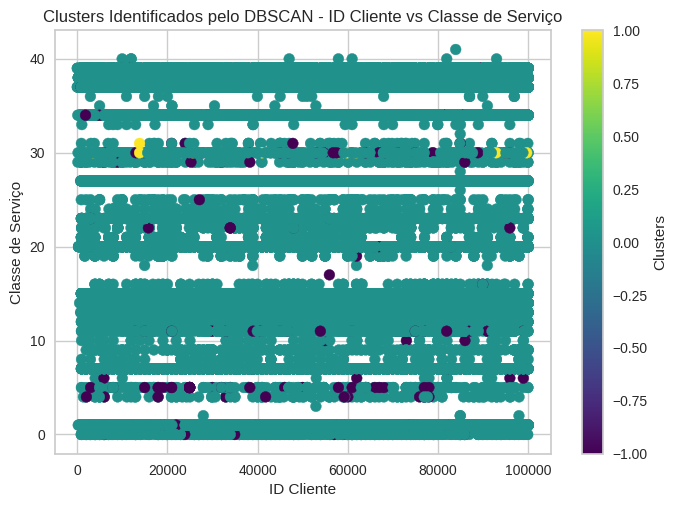

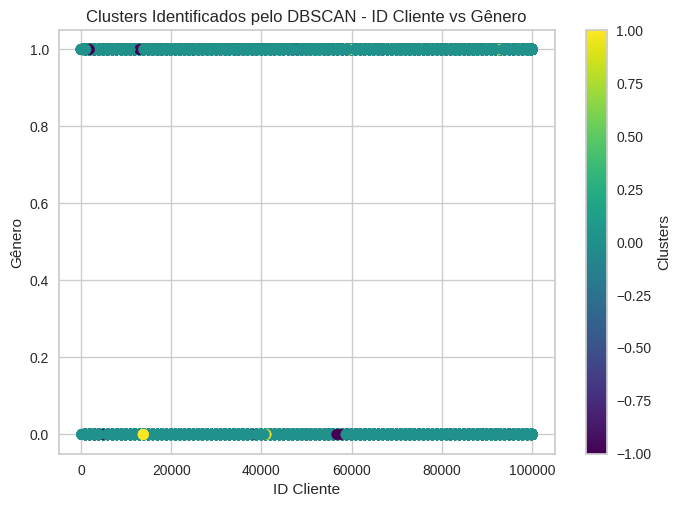

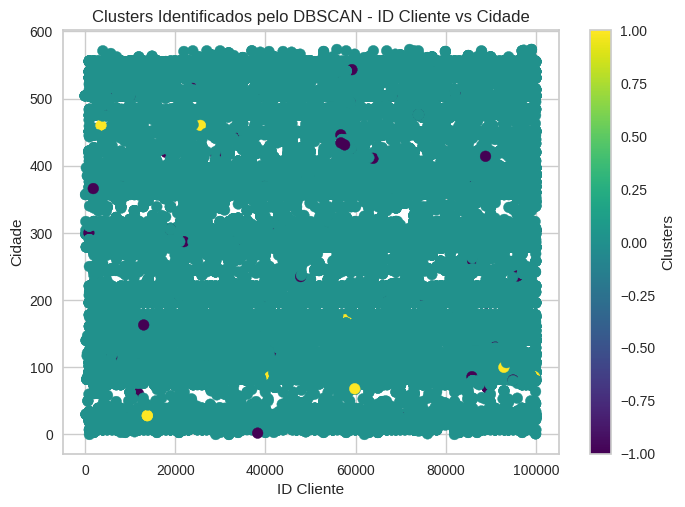

...

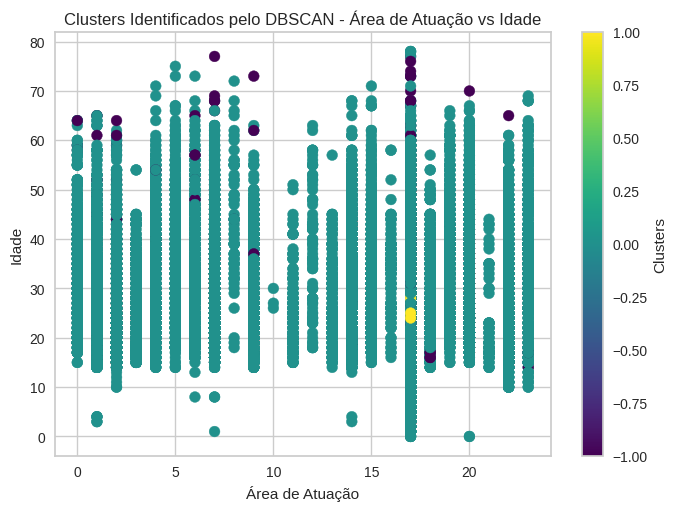

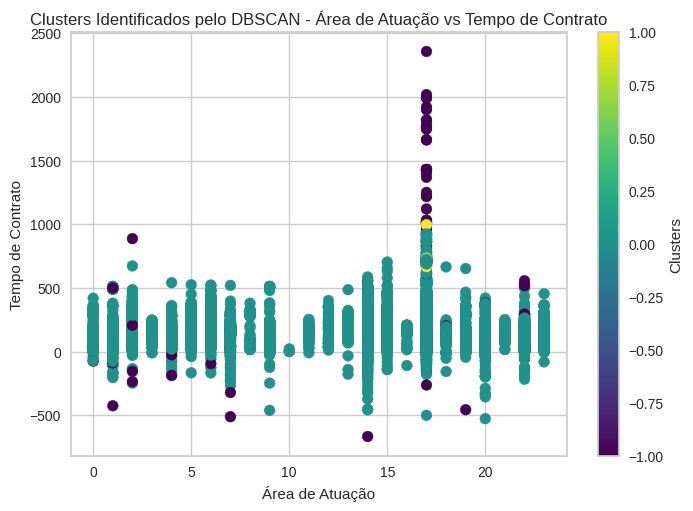

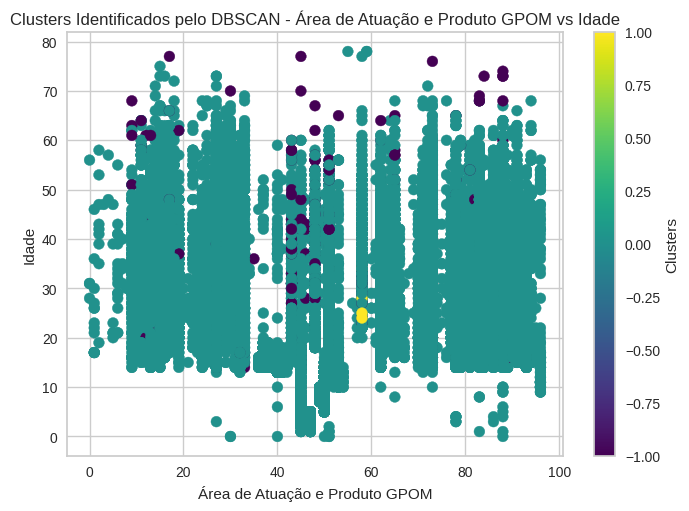

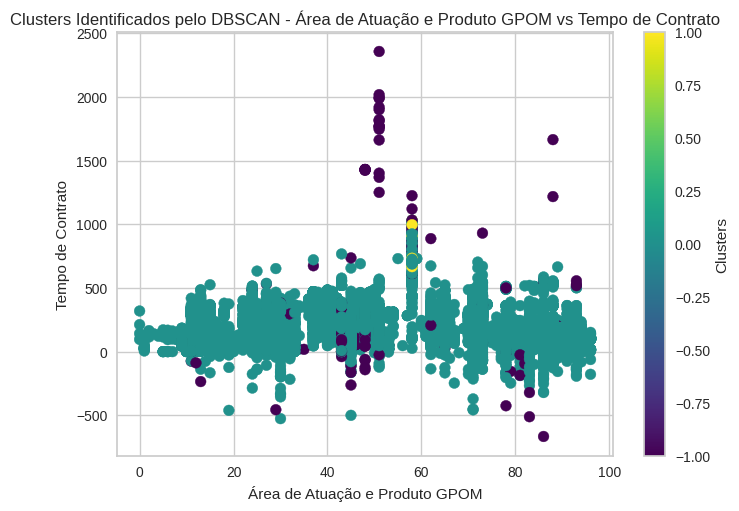

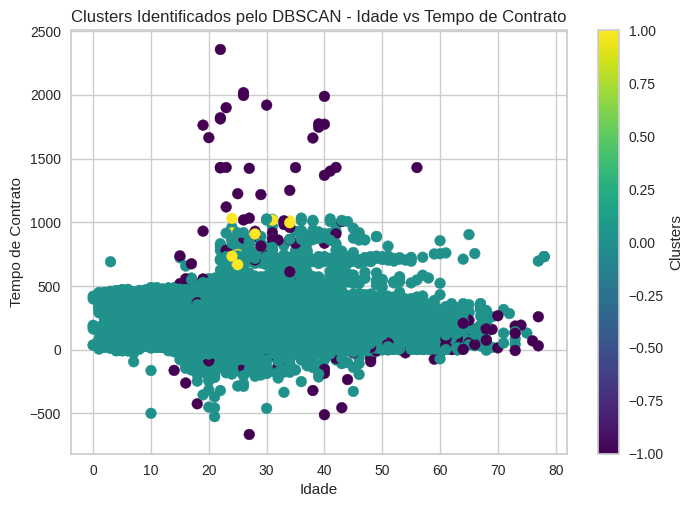

In [41]:
# Exemplo de uso com todas as variáveis possíveis:
colunas = ['ID Cliente', 'Linha de Ação', 'Produto GPOM', 'Classe de Serviço',
           'Gênero', 'Cidade', 'Microrregião', 'Estado', 'Área de Atuação',
           'Área de Atuação e Produto GPOM', 'Idade', 'Tempo de Contrato']

# Vamos visualizar os clusters para todas as combinações possíveis de variáveis:
for i in range(len(colunas)):
    for j in range(i+1, len(colunas)):
        plot_clusters(colunas[i], colunas[j], 'Clusters_DBSCAN')

# 2. Classificação usando Decision Tree, Random Forest e XGBOOST

## 2.1 Preparação dos dados

In [42]:
# df_pf = pd.read_csv('../dados/PF_tratados.csv')
df_pf = pd.read_csv('/home/hub/Área de Trabalho/dados/PF_tratados.csv')
df_pf.head()

,ID Cliente,Linha de Ação,Produto GPOM,Data de Venda,Classe de Serviço,Data de Nascimento,Gênero,Cidade,Microrregião,Estado,Fim de Vigência,Tipo Pessoa,Área de Atuação,Área de Atuação e Produto GPOM,Idade,Tempo de Contrato,Longitude,Latitude
0,56943,EDUCACAO,COLEGIO SESI NOVO ENSINO MEDIO,2022-10-28,ENSINO MEDIO – ITINERARIOS,2008-05-16,MASCULINO,CURITIBA,CURITIBA,PR,2023-12-15,FÍSICA,NÃO INFORMADO,COLEGIO SESI NOVO ENSINO MEDIO / NÃO INFORMADO,14,413,-49.264622,-25.419547
1,19906,EDUCACAO,EDUCACAO INFANTIL,2023-01-13,EDUCACAO INFANTIL - PRE-ESCOLA,1981-08-13,FEMININO,CURITIBA,CURITIBA,PR,2023-12-25,FÍSICA,NÃO INFORMADO,EDUCACAO INFANTIL / NÃO INFORMADO,41,346,-49.264622,-25.419547
2,19906,EDUCACAO,ENSINO FUNDAMENTAL INTERNACIONAL,2021-10-07,ENSINO FUNDAMENTAL - 1º AO 5º ANO,1981-08-13,FEMININO,CURITIBA,CURITIBA,PR,2022-12-14,FÍSICA,NÃO INFORMADO,ENSINO FUNDAMENTAL INTERNACIONAL / NÃO INFORMADO,40,433,-49.264622,-25.419547
3,19906,EDUCACAO,ENSINO FUNDAMENTAL INTERNACIONAL,2023-01-13,ENSINO FUNDAMENTAL - 1º AO 5º ANO,1981-08-13,FEMININO,CURITIBA,CURITIBA,PR,2023-12-25,FÍSICA,NÃO INFORMADO,ENSINO FUNDAMENTAL INTERNACIONAL / NÃO INFORMADO,41,346,-49.264622,-25.419547
4,6940,EDUCACAO,COLEGIO SESI INTERNACIONAL,2021-10-14,ENSINO MEDIO,2006-11-01,FEMININO,CURITIBA,CURITIBA,PR,2022-12-14,FÍSICA,NÃO INFORMADO,COLEGIO SESI INTERNACIONAL / NÃO INFORMADO,14,426,-49.264622,-25.419547


In [43]:
df_pf['Produto GPOM'].value_counts()

TECNICO DE NIVEL MEDIO                                    38282
APERFEICOAMENTO PROFISSIONAL                               9126
GRADUACAO                                                  8755
QUALIFICACAO PROFISSIONAL                                  6914
COLEGIO SESI NOVO ENSINO MEDIO                             5938
COLEGIO SESI                                               4537
EDUCACAO CONTINUADA                                        3490
ENSINO FUNDAMENTAL INTERNACIONAL                           2944
COLEGIO SESI NOVO ENSINO MEDIO INTERNACIONAL                724
COLEGIO SESI INTERNACIONAL                                  635
POS-GRADUACAO                                               595
EJA                                                         428
CURSOS DE EXTENSAO                                          407
EDUCACAO INFANTIL                                           378
APERFEICOAMENTO PROFISSIONAL - E-COMMERCE                   193
INICIACAO PROFISSIONAL                  

In [44]:
cols_del = ['Data de Venda', 'Data de Nascimento', 'Fim de Vigência', 'Tipo Pessoa','Longitude', 'Latitude']
df_pf = df_pf.drop(cols_del, axis=1)

In [45]:
df_pf['TargetA'] = df_pf['Produto GPOM'].apply(lambda x: 1 if x == 'APERFEICOAMENTO PROFISSIONAL' else 0)
df_pf['TargetB'] = df_pf['Produto GPOM'].apply(lambda x: 1 if x == 'GRADUACAO' else 0)
df_pf['TargetC'] = df_pf['Produto GPOM'].apply(lambda x: 1 if x == 'QUALIFICACAO PROFISSIONAL' else 0)
df_pf['TargetD'] = df_pf['Produto GPOM'].apply(lambda x: 1 if x == 'COLEGIO SESI NOVO ENSINO MEDIO' else 0)

In [46]:
df_pf[df_pf['Produto GPOM'] == 'APERFEICOAMENTO PROFISSIONAL']
df_pf[df_pf['Produto GPOM'] == 'GRADUACAO']
df_pf[df_pf['Produto GPOM'] == 'QUALIFICACAO PROFISSIONAL']
df_pf[df_pf['Produto GPOM'] == 'COLEGIO SESI NOVO ENSINO MEDIO']

,ID Cliente,Linha de Ação,Produto GPOM,Classe de Serviço,Gênero,Cidade,Microrregião,Estado,Área de Atuação,Área de Atuação e Produto GPOM,Idade,Tempo de Contrato,TargetA,TargetB,TargetC,TargetD
0,56943,EDUCACAO,COLEGIO SESI NOVO ENSINO MEDIO,ENSINO MEDIO – ITINERARIOS,MASCULINO,CURITIBA,CURITIBA,PR,NÃO INFORMADO,COLEGIO SESI NOVO ENSINO MEDIO / NÃO INFORMADO,14,413,0,0,0,1
8,55920,EDUCACAO,COLEGIO SESI NOVO ENSINO MEDIO,ENSINO MEDIO – ITINERARIOS,FEMININO,CURITIBA,CURITIBA,PR,NÃO INFORMADO,COLEGIO SESI NOVO ENSINO MEDIO / NÃO INFORMADO,15,427,0,0,0,1
11,52969,EDUCACAO,COLEGIO SESI NOVO ENSINO MEDIO,NOVO ENSINO MEDIO,FEMININO,CURITIBA,CURITIBA,PR,NÃO INFORMADO,COLEGIO SESI NOVO ENSINO MEDIO / NÃO INFORMADO,14,438,0,0,0,1
12,18923,EDUCACAO,COLEGIO SESI NOVO ENSINO MEDIO,ENSINO MEDIO – ITINERARIOS,MASCULINO,CURITIBA,CURITIBA,PR,NÃO INFORMADO,COLEGIO SESI NOVO ENSINO MEDIO / NÃO INFORMADO,14,324,0,0,0,1
13,18923,EDUCACAO,COLEGIO SESI NOVO ENSINO MEDIO,ENSINO MEDIO – ITINERARIOS,MASCULINO,CURITIBA,CURITIBA,PR,NÃO INFORMADO,COLEGIO SESI NOVO ENSINO MEDIO / NÃO INFORMADO,15,381,0,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
78537,5090,EDUCACAO,COLEGIO SESI NOVO ENSINO MEDIO,NOVO ENSINO MEDIO,MASCULINO,FLORIANÓPOLIS,OUTRO ESTADO,SC,NÃO INFORMADO,COLEGIO SESI NOVO ENSINO MEDIO / NÃO INFORMADO,16,184,0,0,0,1
78546,80975,EDUCACAO,COLEGIO SESI NOVO ENSINO MEDIO,NOVO ENSINO MEDIO,MASCULINO,SANTA TEREZA DO OESTE,CASCAVEL,PR,NÃO INFORMADO,COLEGIO SESI NOVO ENSINO MEDIO / NÃO INFORMADO,14,324,0,0,0,1
78547,80975,EDUCACAO,COLEGIO SESI NOVO ENSINO MEDIO,NOVO ENSINO MEDIO,MASCULINO,SANTA TEREZA DO OESTE,CASCAVEL,PR,NÃO INFORMADO,COLEGIO SESI NOVO ENSINO MEDIO / NÃO INFORMADO,14,411,0,0,0,1
78597,9905,EDUCACAO,COLEGIO SESI NOVO ENSINO MEDIO,ENSINO MEDIO – ITINERARIOS,FEMININO,PINHÃO,GUARAPUAVA,PR,NÃO INFORMADO,COLEGIO SESI NOVO ENSINO MEDIO / NÃO INFORMADO,15,121,0,0,0,1


In [47]:
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import StandardScaler
s = (df_pf.dtypes == 'object')
object_cols = list(s[s].index)
LE=LabelEncoder()
for i in object_cols:
    df_pf[i]=df_pf[[i]].apply(LE.fit_transform)

In [48]:
df_pf

,ID Cliente,Linha de Ação,Produto GPOM,Classe de Serviço,Gênero,Cidade,Microrregião,Estado,Área de Atuação,Área de Atuação e Produto GPOM,Idade,Tempo de Contrato,TargetA,TargetB,TargetC,TargetD
0,56943,0,10,15,1,140,10,16,17,40,14,413,0,0,0,1
1,19906,0,17,9,0,140,10,16,17,47,41,346,0,0,0,0
2,19906,0,20,12,0,140,10,16,17,50,40,433,0,0,0,0
3,19906,0,20,12,0,140,10,16,17,50,41,346,0,0,0,0
4,6940,0,8,14,0,140,10,16,17,38,14,426,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
83867,13908,0,30,39,1,44,30,16,14,86,41,176,0,0,0,0
83868,60900,0,1,1,1,222,6,16,7,17,29,11,1,0,0,0
83869,1045,0,1,1,1,135,20,21,2,13,19,85,1,0,0,0
83870,69940,0,1,1,1,306,24,16,20,30,30,4,1,0,0,0


In [49]:
std=StandardScaler()
df_scaled = df_pf.copy()

colunas = ['Linha de Ação', 'Produto GPOM', 'Classe de Serviço',
                    'Cidade', 'Microrregião', 'Estado', 'Área de Atuação',
                    'Área de Atuação e Produto GPOM', 'Idade', 'Tempo de Contrato']

df_scaled[colunas] = std.fit_transform(df_scaled[colunas])

In [50]:
df_scaled

,ID Cliente,Linha de Ação,Produto GPOM,Classe de Serviço,Gênero,Cidade,Microrregião,Estado,Área de Atuação,Área de Atuação e Produto GPOM,Idade,Tempo de Contrato,TargetA,TargetB,TargetC,TargetD
0,56943,-0.042048,-1.093611,-0.826463,1,-0.744424,-0.689034,-0.052527,0.481202,-1.018862,-0.989486,1.362836,0,0,0,1
1,19906,-0.042048,-0.423176,-1.272571,0,-0.744424,-0.689034,-0.052527,0.481202,-0.713991,1.651949,0.935530,0,0,0,0
2,19906,-0.042048,-0.135847,-1.049517,0,-0.744424,-0.689034,-0.052527,0.481202,-0.583332,1.554118,1.490391,0,0,0,0
3,19906,-0.042048,-0.135847,-1.049517,0,-0.744424,-0.689034,-0.052527,0.481202,-0.583332,1.651949,0.935530,0,0,0,0
4,6940,-0.042048,-1.285164,-0.900815,0,-0.744424,-0.689034,-0.052527,0.481202,-1.105968,-0.989486,1.445747,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
83867,13908,-0.042048,0.821917,0.957968,1,-1.348113,1.366747,-0.052527,-0.057083,0.984575,1.651949,-0.148681,0,0,0,0
83868,60900,-0.042048,-1.955598,-1.867382,1,-0.228773,-1.100190,-0.052527,-1.313082,-2.020580,0.477978,-1.201003,1,0,0,0
83869,1045,-0.042048,-1.955598,-1.867382,1,-0.775866,0.338856,6.443449,-2.210224,-2.194792,-0.500331,-0.729052,1,0,0,0
83870,69940,-0.042048,-1.955598,-1.867382,1,0.299455,0.750012,-0.052527,1.019487,-1.454392,0.575809,-1.245647,1,0,0,0


## 2.2 Aplicando a classificação usando o Decision Tree

In [51]:
from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import accuracy_score
from sklearn.metrics import classification_report

def treinar_e_avaliar_produto(nome_produto, df_scaled):
    # Dividir os dados em treino e teste
    X_train, X_test, y_train, y_test = train_test_split(
        df_scaled[['Idade', 'Gênero', 'Microrregião']],
        df_scaled[f'Target{nome_produto}'],
        test_size=0.3,
        random_state=42
    )

    # Treinar árvore de decisão
    modelo = DecisionTreeClassifier()
    modelo.fit(X_train, y_train)

    y_pred = modelo.predict(X_test)
    accuracy = accuracy_score(y_test, y_pred)
    print(f'Acurácia para {nome_produto}: {accuracy}')
    print(classification_report(y_test,y_pred))
    return modelo, accuracy

modelo_produtoA, accuracy_produtoA = treinar_e_avaliar_produto('A', df_scaled)
modelo_produtoB, accuracy_produtoB = treinar_e_avaliar_produto('B', df_scaled)
modelo_produtoC, accuracy_produtoC = treinar_e_avaliar_produto('C', df_scaled)
modelo_produtoD, accuracy_produtoC = treinar_e_avaliar_produto('D', df_scaled)

Acurácia para A: 0.8911056354820761
              precision    recall  f1-score   support

           0       0.90      0.99      0.94     22426
           1       0.50      0.10      0.17      2736

    accuracy                           0.89     25162
   macro avg       0.70      0.54      0.55     25162
weighted avg       0.86      0.89      0.86     25162

Acurácia para B: 0.9075192750973691
              precision    recall  f1-score   support

           0       0.92      0.98      0.95     22469
           1       0.64      0.30      0.41      2693

    accuracy                           0.91     25162
   macro avg       0.78      0.64      0.68     25162
weighted avg       0.89      0.91      0.89     25162

Acurácia para C: 0.9146729194817582
              precision    recall  f1-score   support

           0       0.92      1.00      0.96     23058
           1       0.18      0.01      0.01      2104

    accuracy                           0.91     25162
   macro avg       0

## 2.3 Aplicando a classificação usando o Random Forest

In [56]:
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, classification_report

def treinar_e_avaliar_produto(nome_produto, df_scaled):
    # Dividir os dados em treino e teste
    X_train, X_test, y_train, y_test = train_test_split(
        df_scaled[['Idade', 'Gênero', 'Microrregião']],
        df_scaled[f'Target{nome_produto}'],
        test_size=0.3,
        random_state=42
    )

    # Treinar Random Forest
    modelo = RandomForestClassifier()
    modelo.fit(X_train, y_train)

    y_pred = modelo.predict(X_test)
    accuracy = accuracy_score(y_test, y_pred)
    print(f'Acurácia para {nome_produto}: {accuracy}')
    print(classification_report(y_test,y_pred))
    return modelo, accuracy

modelo_produtoA, accuracy_produtoA = treinar_e_avaliar_produto('A', df_scaled)
modelo_produtoB, accuracy_produtoB = treinar_e_avaliar_produto('B', df_scaled)
modelo_produtoC, accuracy_produtoC = treinar_e_avaliar_produto('C', df_scaled)
modelo_produtoD, accuracy_produtoD = treinar_e_avaliar_produto('D', df_scaled)

Acurácia para A: 0.8908671806692632
              precision    recall  f1-score   support

           0       0.90      0.99      0.94     22426
           1       0.49      0.11      0.19      2736

    accuracy                           0.89     25162
   macro avg       0.70      0.55      0.56     25162
weighted avg       0.86      0.89      0.86     25162

Acurácia para B: 0.9074397901597647
              precision    recall  f1-score   support

           0       0.92      0.98      0.95     22469
           1       0.64      0.31      0.42      2693

    accuracy                           0.91     25162
   macro avg       0.78      0.64      0.68     25162
weighted avg       0.89      0.91      0.89     25162

Acurácia para C: 0.9145934345441539
              precision    recall  f1-score   support

           0       0.92      1.00      0.96     23058
           1       0.17      0.01      0.01      2104

    accuracy                           0.91     25162
   macro avg       0

## 2.4 Aplicando a classificação usando o XGBOOST

In [61]:
import xgboost as xgb
from sklearn.datasets import make_classification
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, classification_report

def treinar_e_avaliar_produto(nome_produto, df_scaled):
    # Dividir os dados em treino e teste
    X_train, X_test, y_train, y_test = train_test_split(
        df_scaled[['Idade', 'Gênero', 'Microrregião']],
        df_scaled[f'Target{nome_produto}'],
        test_size=0.2,
        random_state=42
    )

    # Criar o modelo XGBoost para classificação
    model = xgb.XGBClassifier(
        objective='multi:softmax',
        num_class=num_classes,
        max_depth=3,
        learning_rate=0.1,
        n_estimators=100  # Adicione o número desejado de árvores (num_boost_round)
    )

    # Treinar o modelo
    model.fit(X_train, y_train)

    # Faz previsões no conjunto de teste
    predictions = model.predict(X_test)

    # Avalia o desempenho usando a acurácia
    accuracy = accuracy_score(y_test, predictions)
    print(f'Acurácia para {nome_produto}: {accuracy}')

    # Avalia o desempenho usando o classification report
    report = classification_report(y_test, predictions, zero_division=1)
    print(f'Classification Report para {nome_produto}:\n{report}')

    return model, accuracy

# Número de classes
num_classes = 2 

modelo_produtoA, accuracy_produtoA = treinar_e_avaliar_produto('A', df_scaled)
modelo_produtoB, accuracy_produtoB = treinar_e_avaliar_produto('B', df_scaled)
modelo_produtoC, accuracy_produtoC = treinar_e_avaliar_produto('C', df_scaled)
modelo_produtoD, accuracy_produtoD = treinar_e_avaliar_produto('D', df_scaled)

Acurácia para A: 0.8921013412816692
Classification Report para A:
              precision    recall  f1-score   support

           0       0.89      1.00      0.94     14925
           1       0.67      0.04      0.08      1850

    accuracy                           0.89     16775
   macro avg       0.78      0.52      0.51     16775
weighted avg       0.87      0.89      0.85     16775

Acurácia para B: 0.9072429210134129
Classification Report para B:
              precision    recall  f1-score   support

           0       0.92      0.98      0.95     14976
           1       0.66      0.28      0.40      1799

    accuracy                           0.91     16775
   macro avg       0.79      0.63      0.67     16775
weighted avg       0.89      0.91      0.89     16775

Acurácia para C: 0.915886736214605
Classification Report para C:
              precision    recall  f1-score   support

           0       0.92      1.00      0.96     15364
           1       1.00      0.00      0